# Predict Calorie Expenditure
In this notebook, we will be predicting the calorie expenditure of a person based on the given dataset. You can find the competition and the dataset [here](https://www.kaggle.com/competitions/playground-series-s5e5).

<div align="center">
<img src="https://www.kaggle.com/competitions/91716/images/header" />
</div>

## 1. Importing Libraries

In [34]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler, OrdinalEncoder
import joblib
import lightgbm as lgb
import xgboost as xgb
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.tree import ExtraTreeRegressor, DecisionTreeRegressor
from sklearn.ensemble import GradientBoostingRegressor, RandomForestRegressor
from sklearn.neighbors import KNeighborsRegressor
from tqdm.notebook import tqdm
from sklearn.metrics import r2_score, mean_squared_error

import warnings

### Configurations

In [2]:
warnings.filterwarnings('ignore')
plt.style.use('fivethirtyeight')
plt.rcParams['figure.figsize'] = (12, 8)
sns.set_style('darkgrid')

## 2. Loading Data

In [3]:
df = pd.read_csv('train.csv', index_col='id')

In [4]:
df.head()

,Sex,Age,Height,Weight,Duration,Heart_Rate,Body_Temp,Calories
id,,,,,,,,
0,male,36,189.0,82.0,26.0,101.0,41.0,150.0
1,female,64,163.0,60.0,8.0,85.0,39.7,34.0
2,female,51,161.0,64.0,7.0,84.0,39.8,29.0
3,male,20,192.0,90.0,25.0,105.0,40.7,140.0
4,female,38,166.0,61.0,25.0,102.0,40.6,146.0


In [5]:
df.shape

(750000, 8)

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 750000 entries, 0 to 749999
Data columns (total 8 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   Sex         750000 non-null  object 
 1   Age         750000 non-null  int64  
 2   Height      750000 non-null  float64
 3   Weight      750000 non-null  float64
 4   Duration    750000 non-null  float64
 5   Heart_Rate  750000 non-null  float64
 6   Body_Temp   750000 non-null  float64
 7   Calories    750000 non-null  float64
dtypes: float64(6), int64(1), object(1)
memory usage: 51.5+ MB


In [7]:
df.isnull().sum()

Sex           0
Age           0
Height        0
Weight        0
Duration      0
Heart_Rate    0
Body_Temp     0
Calories      0
dtype: int64

In [8]:
df.duplicated().sum()

np.int64(2841)

In [9]:
df.drop_duplicates(inplace=True)

## 3. Exploratory Data Analysis

In [10]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Age,747159.0,41.419769,15.183108,20.0,28.0,40.0,52.0,79.0
Height,747159.0,174.694787,12.820127,126.0,164.0,174.0,185.0,222.0
Weight,747159.0,75.140631,13.976613,36.0,63.0,74.0,87.0,132.0
Duration,747159.0,15.433359,8.352766,1.0,8.0,15.0,23.0,30.0
Heart_Rate,747159.0,95.495497,9.451046,67.0,88.0,95.0,103.0,128.0
Body_Temp,747159.0,40.037302,0.779242,37.1,39.6,40.3,40.7,41.5
Calories,747159.0,88.364584,62.398057,1.0,34.0,77.0,136.0,314.0


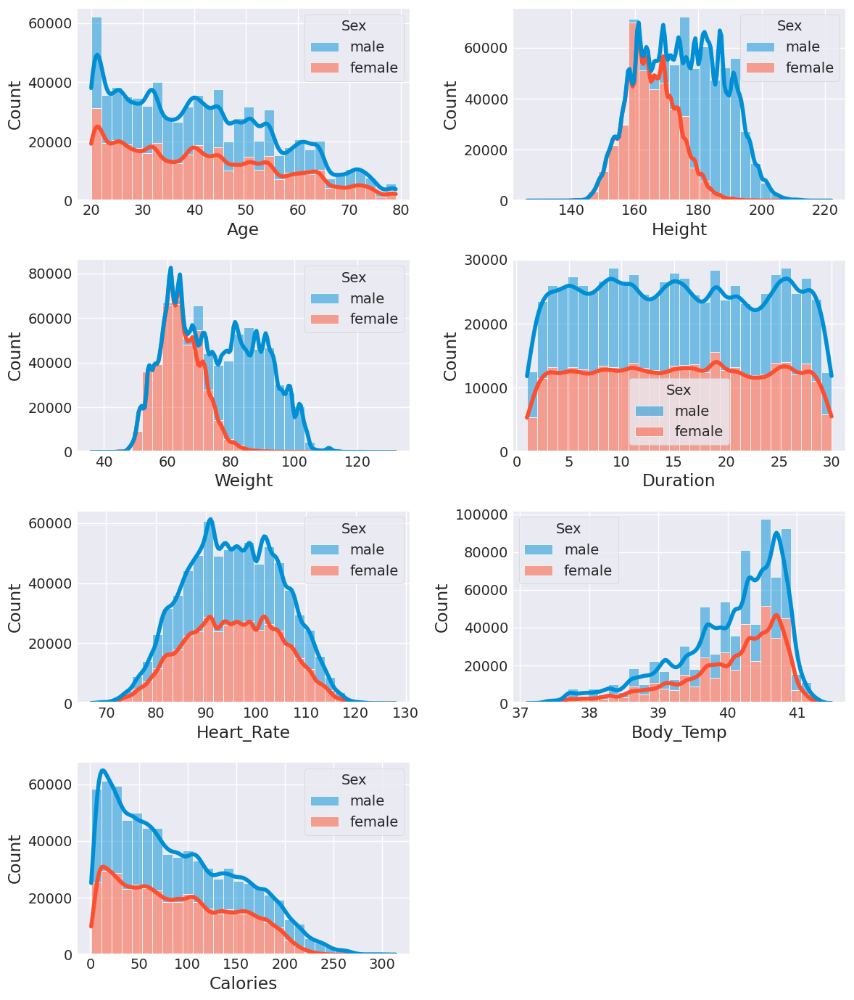

In [11]:
plt.figure(figsize=(12, 14))
for i, c in enumerate(df.columns[1:]):
    plt.subplot(4, 2, i+1)
    sns.histplot(df, x=c, hue='Sex', multiple='stack', bins=30, kde=True)
plt.tight_layout()

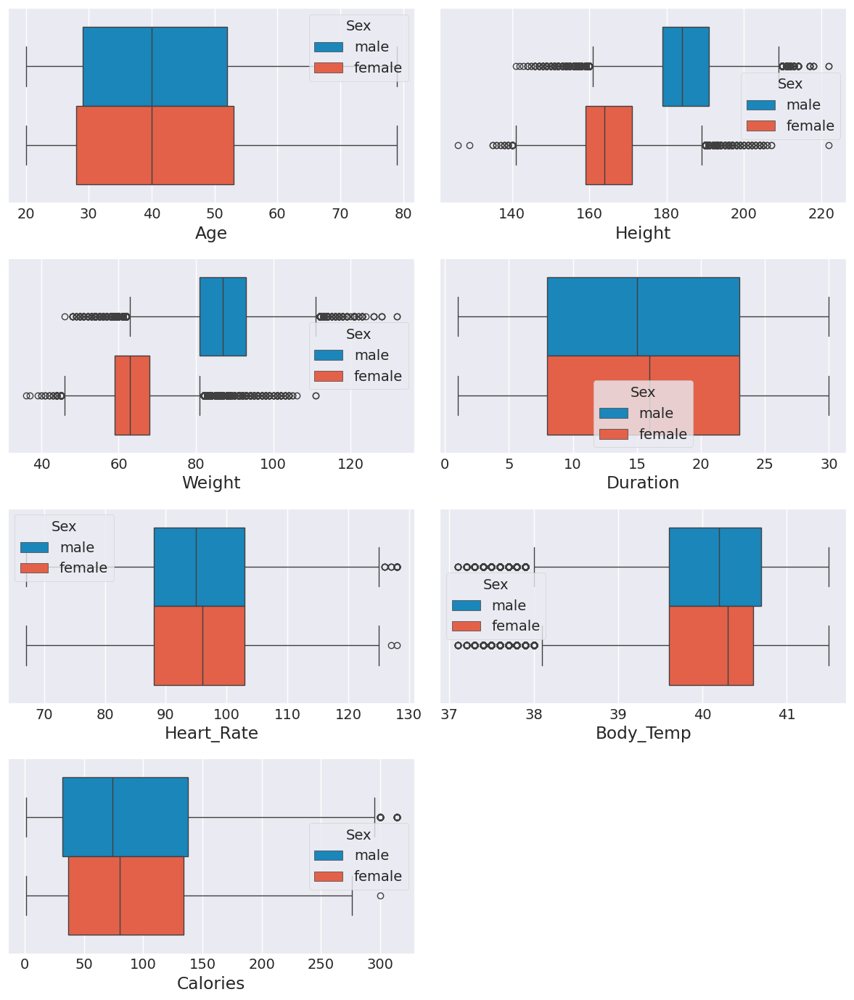

In [12]:
plt.figure(figsize=(12, 14))
for i, c in enumerate(df.columns[1:]):
    plt.subplot(4, 2, i+1)
    sns.boxplot(df, x=c, hue='Sex', orient='h')

plt.tight_layout()

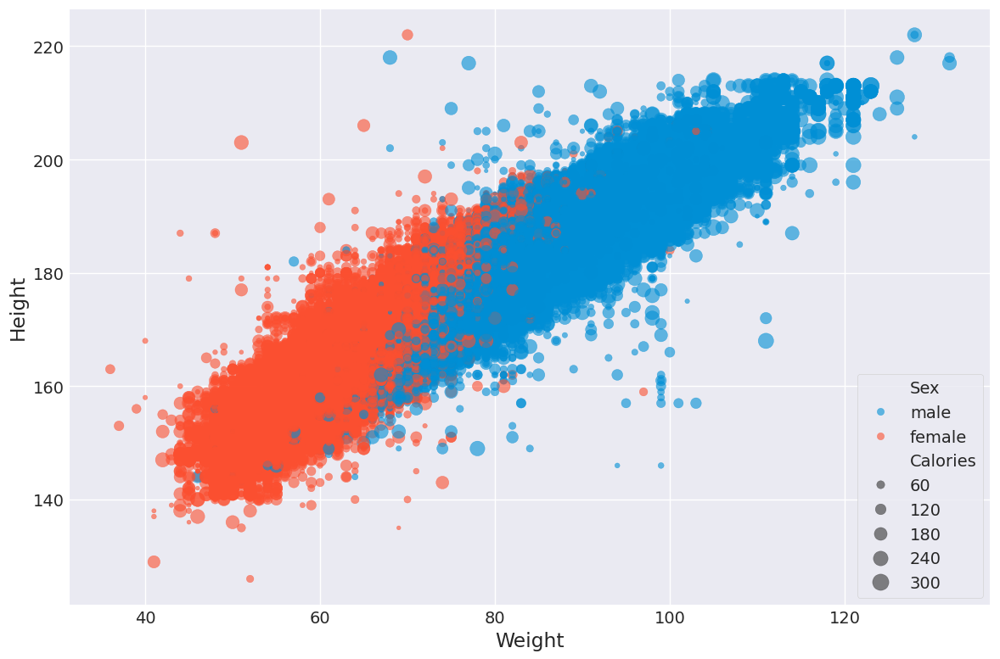

In [13]:
sns.scatterplot(
    df,
    x='Weight',
    y='Height',
    hue='Sex',
    size='Calories',
    sizes=(10, 200),
    alpha=0.6,
    edgecolor=None
)
plt.tight_layout()

In [14]:
px.scatter(
    df,
    x='Weight',
    y='Height',
    color='Sex',
    size='Calories'
)

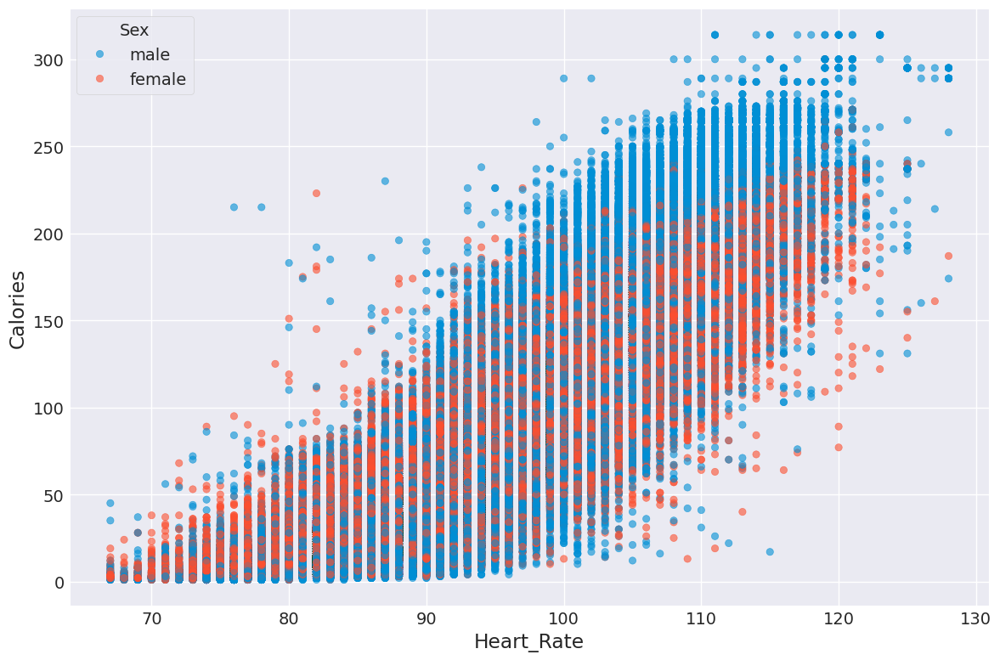

In [15]:
sns.scatterplot(
    df,
    x='Heart_Rate',
    y='Calories',
    hue='Sex',
    alpha=0.6,
    edgecolor=None
)
plt.tight_layout()

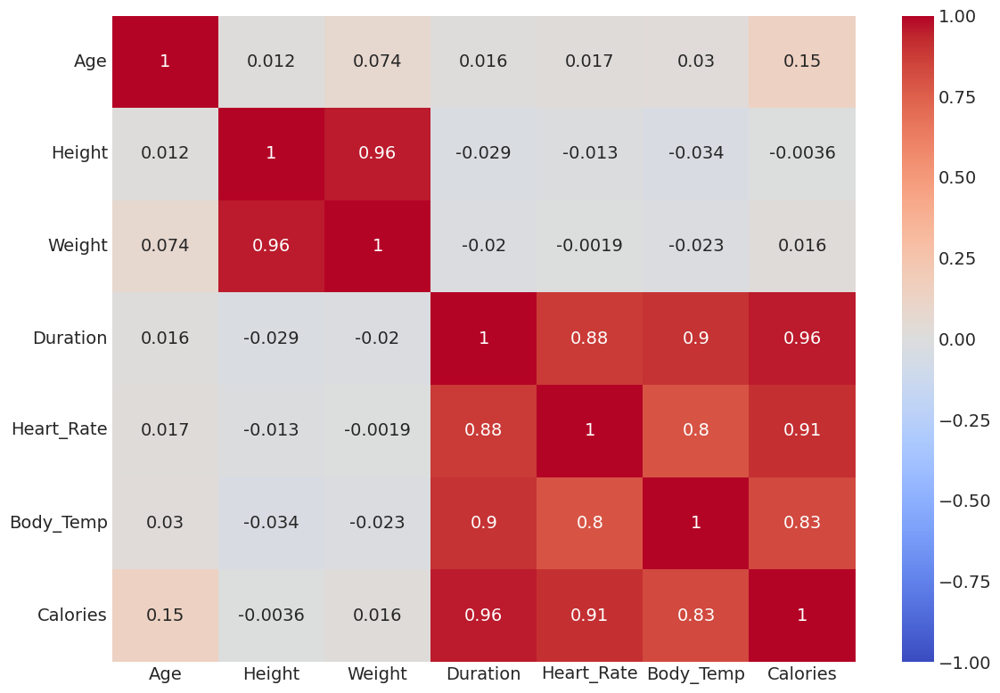

In [17]:
sns.heatmap(
    df.corr(numeric_only=True),
    annot=True,
    cmap='coolwarm',
    vmin=-1,
    vmax=1
)
plt.tight_layout()

In [18]:
df.corr(numeric_only=True)['Calories'].sort_values(ascending=False)

Calories      1.000000
Duration      0.959869
Heart_Rate    0.908644
Body_Temp     0.828693
Age           0.145774
Weight        0.016333
Height       -0.003555
Name: Calories, dtype: float64

## 4. Data Preprocessing

In [20]:
x = df.drop(columns=['Calories', 'Height', 'Weight'])
y = df[['Calories']]

In [23]:
x['Sex'] = x['Sex'].map({'male': 1, 'female': 0})

In [26]:
scaler = MinMaxScaler()
x_scaled = scaler.fit_transform(x)

In [27]:
x_train, x_test, y_train, y_test = train_test_split(x_scaled, y, test_size=0.2, random_state=42)

## 5. Model Training

In [29]:
models = {
    "LinearRegression": LinearRegression(),
    "Ridge": Ridge(),
    "Lasso": Lasso(),
    "DecisionTreeRegressor": DecisionTreeRegressor(),
    "ExtraTreeRegressor": ExtraTreeRegressor(),
    "KNeighborsRegressor": KNeighborsRegressor(n_neighbors=5),
    "LightGBM": lgb.LGBMRegressor(verbose=-1),
    "XGBoost": xgb.XGBRegressor(),
    "GradientBoostingRegressor": GradientBoostingRegressor(),
    "RandomForestRegressor": RandomForestRegressor()
}


def evaluate(x_train, y_train, x_test, y_test):
    results = []
    for name, model in tqdm(models.items()):
        print(f"Training {name} model...")
        y_pred = model.fit(x_train, y_train).predict(x_test)
        
        results.append({
            "Model": name,
            "R2_Score": r2_score(y_test, y_pred),
            "MSE": mean_squared_error(y_test, y_pred),
            "RMSE": mean_squared_error(y_test, y_pred)**0.5
        })
    report = pd.DataFrame(results).sort_values('R2_Score', ascending=False)
    report.reset_index(drop=True, inplace=True)
    return report

In [30]:
evaluate(x_train, y_train, x_test, y_test)

  0%|          | 0/10 [00:00<?, ?it/s]

Training LinearRegression model...
Training Ridge model...
Training Lasso model...
Training DecisionTreeRegressor model...
Training ExtraTreeRegressor model...
Training KNeighborsRegressor model...
Training LightGBM model...
Training XGBoost model...
Training GradientBoostingRegressor model...
Training RandomForestRegressor model...


,Model,R2_Score,MSE,RMSE
0,XGBoost,0.995175,18.714884,4.326070
1,LightGBM,0.995084,19.068678,4.366770
2,KNeighborsRegressor,0.994497,21.345677,4.620138
3,RandomForestRegressor,0.994408,21.693438,4.657622
4,GradientBoostingRegressor,0.993571,24.940132,4.994010
5,ExtraTreeRegressor,0.992611,28.662938,5.353778
6,DecisionTreeRegressor,0.992490,29.132095,5.397416
7,Ridge,0.967960,124.285654,11.148348
8,LinearRegression,0.967960,124.285969,11.148362
9,Lasso,0.938854,237.192031,15.401040


## 6. Build Pipeline with the best model, Save the model, Make Submission

In [42]:
x = df.drop(columns=['Calories', 'Height', 'Weight'])
y = df[['Calories']]

In [44]:
preprocessor = ColumnTransformer([
    ('scaler', MinMaxScaler(), x.columns[1:]),
    ('encoder', OrdinalEncoder(), ['Sex'])
])

pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('model', xgb.XGBRegressor(random_state=42))
])

pipeline.fit(x, y)

,steps,"[('preprocessor', ...), ('model', ...)]"
,transform_input,None
,memory,None
,verbose,False
,transformers,"[('scaler', ...), ('encoder', ...)]"
,remainder,'drop'
,sparse_threshold,0.3
,n_jobs,None
,transformer_weights,None
,verbose,False
,verbose_feature_names_out,True


In [45]:
y_pred = pipeline.predict(x)

print(f'R2 Score : {r2_score(y, y_pred)}')
print(f'MSE      : {mean_squared_error(y, y_pred)}')
print(f'RMSE     : {mean_squared_error(y, y_pred)**0.5}')

R2 Score : 0.9955567121505737
MSE      : 17.300018310546875
RMSE     : 4.159329069759554


In [46]:
joblib.dump(pipeline, 'calorie_prediction_pipeline.pkl')

['calorie_prediction_pipeline.pkl']

In [47]:
test_df = pd.read_csv('test.csv', index_col='id')
predictions = pipeline.predict(test_df)
submission = pd.DataFrame({
    'id': test_df.index,
    'Calories': predictions
})
submission.head()

,id,Calories
0,750000,27.957411
1,750001,101.503922
2,750002,89.802025
3,750003,127.327385
4,750004,76.761559


In [48]:
submission.to_csv('submission.csv', index=False)

## 7. Conclusion
We built a machine learning pipeline to predict the calorie expenditure of a person based on the given dataset. We used the `XGBRegressor` as the best model. We saved the pipeline for future use and used it to generate predictions for the submission.